### Independent Component Analysis (ICA)

**Independent Component Analysis (ICA)** is a computational technique for separating a multivariate signal into additive, independent non-Gaussian components. It is often used to solve the **blind source separation** problem, where the objective is to recover original source signals from observed linear mixtures.

#### The Mixing Model
Suppose we observe $ n $ linear mixtures, denoted as $ \mathbf{x} = [x_1, x_2, \dots, x_n]^T $, where each mixture $ x_i $ is a combination of $ n $ independent components $ \mathbf{s} = [s_1, s_2, \dots, s_n]^T $. The relationship between the observed mixtures and the independent sources can be expressed as:
$$
\mathbf{x} = \mathbf{A} \mathbf{s}
$$
where:
- $ \mathbf{A} $ is the **mixing matrix**, containing coefficients $ a_{ij} $ that describe how the sources combine into the mixtures.
- $ \mathbf{s} $ are the original independent source signals we aim to recover.

To recover the sources, we define an **unmixing matrix** $ \mathbf{W} $, which is the inverse of $ \mathbf{A} $, such that:
$$
\mathbf{s} = \mathbf{W} \mathbf{x}
$$

#### Key Assumptions for ICA
For ICA to work effectively, the following assumptions are required:
1. **Statistical Independence**: The source signals $ s_1, s_2, \dots, s_n $ are statistically independent of one another.
2. **Non-Gaussianity**: The source signals must have non-Gaussian distributions (at least one of them must be non-Gaussian).
3. **Square Mixing Matrix**: For simplicity, we assume $ \mathbf{A} $ is a square matrix, meaning the number of sources equals the number of observed mixtures.

#### Solving ICA with Maximum Likelihood
One approach to solve the ICA problem (the one we saw during the course) is through **Maximum Likelihood Estimation (MLE)**, where the log-likelihood of the unmixing matrix $ \mathbf{W} $ is maximized:
$$
l(\mathbf{W}) = \sum_{i=1}^m \left( \sum_{j=1}^k \log p_s(w_j^T \mathbf{x}) + \log |\det(\mathbf{W})| \right)
$$
where $ p_s $ represents the density function of the independent sources (we saw that if the source densities are unknown, a general sigmoid function can be used as an approximation).

#### Challenges and Advances in ICA
While solving ICA, a critical challenge is to measure **independence**. An initial naive approach was to enforce uncorrelation between the recovered sources, but **uncorrelated signals are not necessarily independent**. A more effective approach leverages **non-Gaussianity**, based on the following principle derived from the **Central Limit Theorem**:
> The sum of two independent non-Gaussian signals is more Gaussian than either of the original signals.

Thus, a better approach would be optimize $ \mathbf{W} $ to ensure that the resulting signals of $ \mathbf{W} \mathbf{x} $ are as non-Gaussian as possible.

#### Measuring Non-Gaussianity
However, to use non-Gaussianity in ICA estimation is necessary to have a quantitative measure of nongaussianity of a random variable. About this several contrast functions have been proposed. One popular and successful measure is an approximation of **negentropy**, which led to the development of the widely used **FastICA algorithm**. If you are interested in a a deeper understanding of this topic, you can refer to https://www.cs.jhu.edu/~ayuille/courses/Stat161-261-Spring14/HyvO00-icatut.pdf

#### FastICA
**FastICA** is one of the most efficient and widely used algorithms for solving the ICA problem. It works by iteratively optimizing the **non-Gaussianity** of the recovered signals, using an approximation of negentropy. The key steps in FastICA are:
1. **Centering and Whitening**: The observed mixtures are first preprocessed to have zero mean and unit variance (whitening) to simplify the optimization problem.
2. **Optimization via Fixed-Point Iteration**: FastICA iteratively updates $ \mathbf{W} $ to maximize non-Gaussianity of $ \mathbf{s} = \mathbf{W} \mathbf{x} $ using a fixed-point algorithm, which is faster and more robust than traditional gradient-based methods.
3. **Deflationary Approach**: Independent components are extracted one by one, ensuring that previously extracted components remain orthogonal to the new ones.

In the notebook, we applied FastICA to separate mixed signals (i.e. simple signals, sounds, images) into their independent components, demonstrating its ability to effectively recover the original sources.


In [ ]:
# uncomment this just the first time to download the following libraries inside the ml_venv
"""
! pip install scipy
! pip install librosa 
! pip install pillow
"""

In [1]:
import numpy as np
from matplotlib import pyplot as plt

from scipy import signal
from sklearn.decomposition import FastICA

import librosa
from IPython.display import Audio, display

from PIL import Image

### Toy Signals

Let's first consider a simple example using synthetic data. In this example, we generate three independent source signals:
1. **Signal 1**: A sinusoidal wave $ s_1 = \sin(2 \cdot \text{time}) $.
2. **Signal 2**: A square wave $ s_2 = \text{sign}(\sin(3 \cdot \text{time})) $.
3. **Signal 3**: A sawtooth wave $ s_3 = \text{sawtooth}(2 \cdot \pi \cdot \text{time}) $.

To simulate real-world data, we add Gaussian noise to the sources, which introduces some level of randomness. The independent sources are then combined linearly using a **mixing matrix** $ \mathbf{A} $, resulting in the mixed signals $ \mathbf{X} $.

Our goal is to recover the original independent sources $ \mathbf{S} $ from the observed mixtures $ \mathbf{X} $. To achieve this, we apply **FastICA** with three components, aiming to estimate the unmixing matrix and reconstruct the sources as $ \mathbf{S}_{\text{pred}} $.

The plots below compare:
1. The mixed signals $ \mathbf{X} $: These are the observed signals, which are **linear** combinations of the original sources.
2. The original independent sources $ \mathbf{S} $: These represent the true underlying signals, including added noise.
3. The predicted independent sources $ \mathbf{S}_{\text{pred}} $: These are the sources recovered using FastICA.

Each signal is plotted in a different color for clarity.


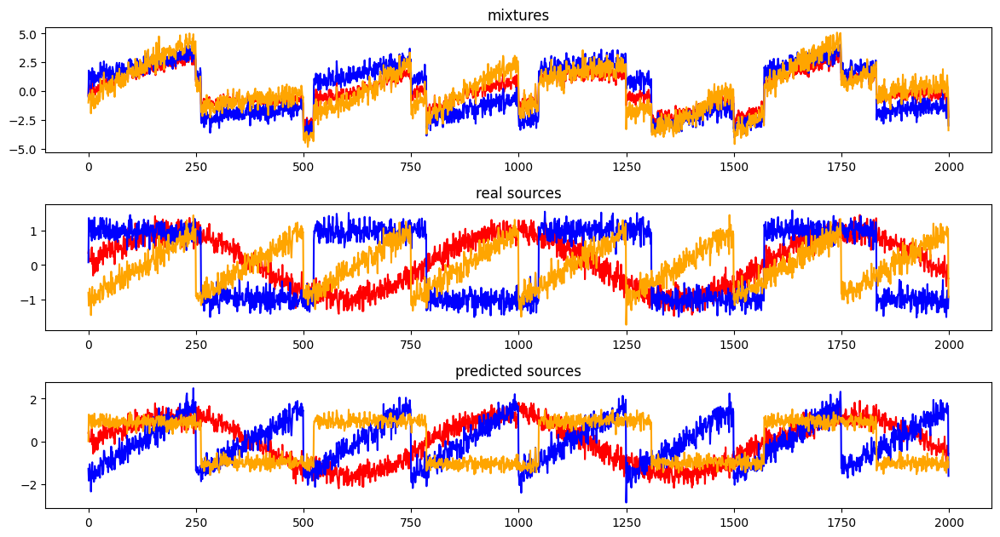

In [2]:
np.random.seed(0)

# Generate sample data
n_samples = 2000
time = np.linspace(0, 8, n_samples)

s1 = np.sin(2 * time)  # Signal 1 : sinusoidal signal
s2 = np.sign(np.sin(3 * time))  # Signal 2 : square signal
s3 = signal.sawtooth(2 * np.pi * time)  # Signal 3: saw tooth signal

S = np.c_[s1, s2, s3]
S += 0.2 * np.random.normal(size=S.shape) # Add some random noise to our sources

# Our objective is given X to learn A, so that we can easily obtain S
A = np.array([[1, 1, 1], [0.5, 2, 1.0], [1.5, 1.0, 2.0]]) # Mixing matrix
X = np.dot(S, A.T) # Mixed Signal

# Fit ICA
ica = FastICA(n_components=3, random_state=0)
# ica = FastICA(n_components=3, random_state=0, whiten='unit-variance')
S_pred = ica.fit_transform(X, ) # Predicted Sources

models = [X, S, S_pred]
names = ['mixtures', 'real sources', 'predicted sources']
colors = ['red', 'blue', 'orange']

fig = plt.figure(figsize=(11.7,8.27))
for i, (name, model) in enumerate(zip(names, models)):
    plt.subplot(4, 1, i+1)
    plt.title(name)
    for sig, color in zip (model.T, colors):
        plt.plot(sig, color=color)
        
fig.tight_layout()        
plt.show()

As we can see the recovered sources may differ in order and sign due to **ICA's inherent ambiguities**.

In [5]:
# OPTIONAL
# Transform the sources back to the mixed data (apply mixing matrix)
# mixed_data_reconstructed = ica.inverse_transform(S_pred)

---

### Cocktail Party Problem: Introduction
Consider $ k $ speakers which are talking simultaneously in a room at a party. In the room are present $ k $ microphones, each placed at a different position in the room, so each captures a unique mixture of the $ k $ speakers' voices due to varying distances from the speakers. The challenge that the Cocktail Party Problem poses is: "Using these microphone recordings, can we separate out the original $ k $ speakers' speech signals?"

##### Audio Sources
Here we are simulating the Cocktail Party Problem considering multiple audio sources mixed together.
We use four audio files (.mp3), each representing a different speaker (source):
 - Washington - American Woman
 - New York - American Man
 - Miami - Australian Woman
 - Chicago - British Woman

Let's listen to these original sources to understand the inputs.


In [6]:
# Paths to audio files
original_paths = [
    "./ICA_Cocktail_Party_Problem/sounds/Washinton - American Woman.mp3",
    "./ICA_Cocktail_Party_Problem/sounds/New York - American Man.mp3",
    "./ICA_Cocktail_Party_Problem/sounds/Miami - Australian Woman.mp3",
    "./ICA_Cocktail_Party_Problem/sounds/Chicago - British Woman.mp3"
]

# Load the original audio signals (20 seconds at 44100 Hz)
original_audios = [librosa.load(path, sr=44100)[0][:44100 * 20] for path in original_paths]

# Play the original signals
for i, original_signal in enumerate(original_audios):
    print(f"Original Signal {i+1}")
    display(Audio(original_signal, rate=44100))

Original Signal 1


Original Signal 2


Original Signal 3


Original Signal 4


**Mixing the Audio Signals**

To simulate the problem, we generate a **4x4 non-singular mixing matrix** and apply it to the original audio signals.
This transforms the sources into **mixed signals**, which combine the voices into overlapping recordings.

**Note**: It is crucial to use a **non-singular** mixing matrix to ensure that the mixed signals could be properly separated:
- If the mixing matrix is singular, the signals are dependent, meaning that some signals are perfectly correlated or one can be reconstructed from others. In this case, ICA won't work as intended because it relies on the assumption of independence.
- Moroever, a non-singular matrix is invertible, which is a necessary condition for separating the mixed signals into their original independent components.

In [7]:
# Stack the audio signals into a matrix (shape: 4x4)
audio_matrix = np.vstack(original_audios)

# Generate a non-singular 4x4 mixing matrix (ensure its determinant is non-zero)
mixing_matrix = np.random.rand(4, 4)
while np.linalg.det(mixing_matrix) == 0:  # This ensures it's non-singular
    mixing_matrix = np.random.rand(4, 4)

# Mix the audio signals
mixed_signals = mixing_matrix @ audio_matrix

Below, we visualize these mixed signals to observe how the sources are combined, and we also listen to them.

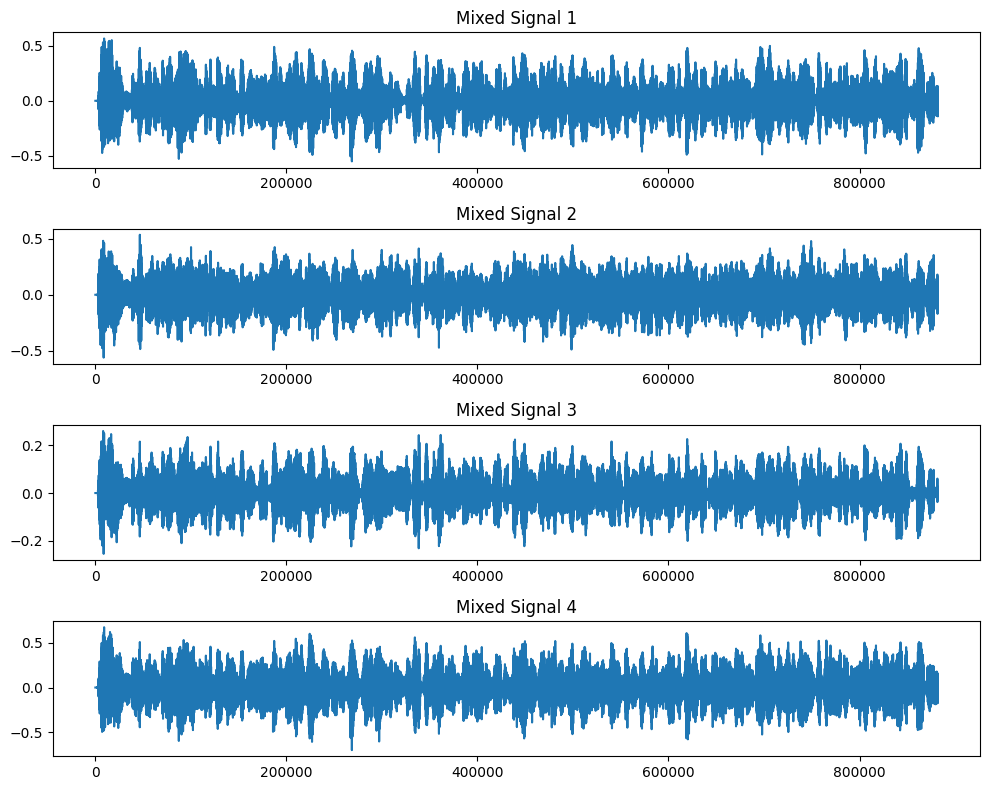

Mixed Signal 1


Mixed Signal 2


Mixed Signal 3


Mixed Signal 4


In [8]:
# Plot the mixed signals
plt.figure(figsize=(10, 8))
for i in range(4):
    plt.subplot(4, 1, i + 1)
    plt.plot(mixed_signals[i])
    plt.title(f'Mixed Signal {i+1}')
plt.tight_layout()
plt.show()

# Play the mixed signals
for i, mixed_signal in enumerate(mixed_signals):
    print(f"Mixed Signal {i+1}")
    display(Audio(mixed_signal, rate=44100))


**Objective: Recover Original Sources**

Listening to the mixed signals, you can clearly hear multiple recordings combined into each.
Our goal is to recover the original separated sources (the **independent components**) from these mixed signals.
To achieve this, we will apply again the FastICA algorithm and assess its ability to separate the signals into their original components.

In [9]:
# Transpose the mixed signals for ICA
mixed_signals = mixed_signals.T

# Apply FastICA
ica = FastICA(n_components=4, random_state=0)
recovered_sources = ica.fit_transform(mixed_signals)

# Transpose back for easier processing (optional)
recovered_sources = recovered_sources.T

**Recovered Sources**

Once FastICA has separated the mixed signals, we can listen to these recovered signals to verify the separation quality.


In [10]:
# Play the recovered sources
for i, source in enumerate(recovered_sources):
    print(f"Recovered Source {i+1}")
    display(Audio(source, rate=44100))


Recovered Source 1


Recovered Source 2


Recovered Source 3


Recovered Source 4


Moreover, we can plot the recovered sources to visually compare them with the originals.

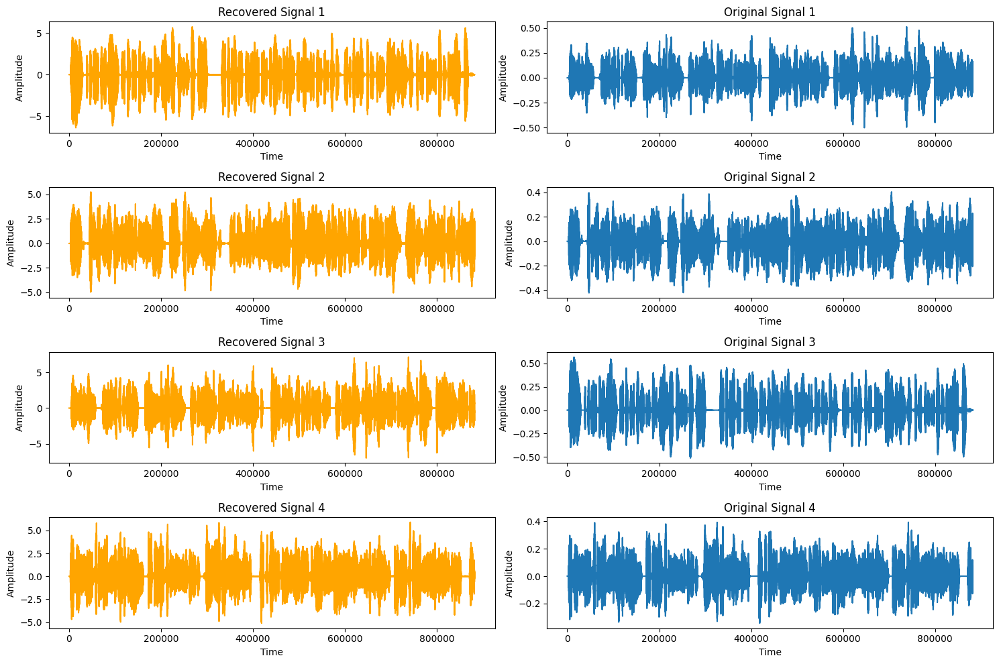

Correlations for Recovered Source 1: [-0.000452540011776517, -0.0017347209601548332, -0.999989799813478, 0.0033963175627273936]
Correlations for Recovered Source 2: [-0.003144204435646974, -0.9999704470676287, 0.0007122549217746241, -0.010552487221678076]
Correlations for Recovered Source 3: [0.9999733292803564, -0.007298657293360822, 0.004245217673964785, -0.001441487736572348]
Correlations for Recovered Source 4: [0.006576466677740325, -0.0016808736664750883, 0.0013678774898757467, 0.999937514124535]


In [ ]:
# Number of signals (sources)
n_sources = len(original_audios)

# Plotting the original and recovered signals together
plt.figure(figsize=(15, 10))
for i in range(n_sources):

    plt.subplot(n_sources, 2, 2 * i + 1)
    plt.plot(recovered_sources[i], label=f"Recovered Signal {i+1}", color='orange')
    plt.title(f'Recovered Signal {i+1}')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')

    plt.subplot(n_sources, 2, 2 * i + 2)
    plt.plot(original_audios[i], label=f"Original Signal {i+1}")
    plt.title(f'Original Signal {i+1}')
    plt.xlabel('Time')
    plt.ylabel('Amplitude')

plt.tight_layout()
plt.show()

for i, source in enumerate(recovered_sources):
    correlations = [np.corrcoef(source, original_audios[j])[0, 1] for j in range(4)]
    print(f"Correlations for Recovered Source {i+1}: {correlations}")


We can see that the reconstructed signals are almost identical to the original ones:
- the recovered signal 1 matches the original signal 3
- the recovered signal 2 matches the original signal 2
- the recovered signal 3 matches the original signal 1
- the recovered signal 4 matches the original signal 4
Again the order of the recovered sources is changed due to ICA's inherent ambiguities.

**Note**: Here, to further verify the quality of separation, we also calculate the correlation between the recovered sources and the original signals. This provides a quantitative measure of how well the original components were recovered.

These results demonstrate the strength of ICA in recovering independent sources from mixed signals.

---

#### Image Sources
Below is also shown an exmaple of the application of Fast ICA to images

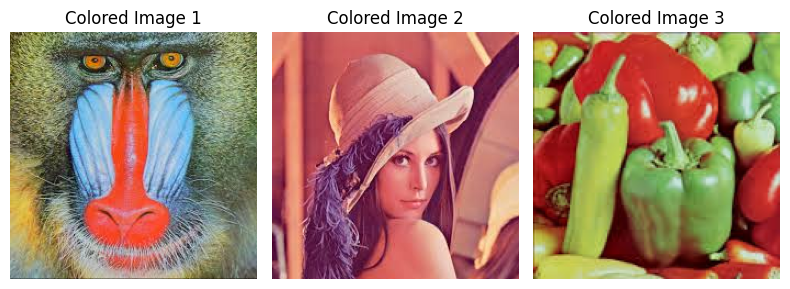

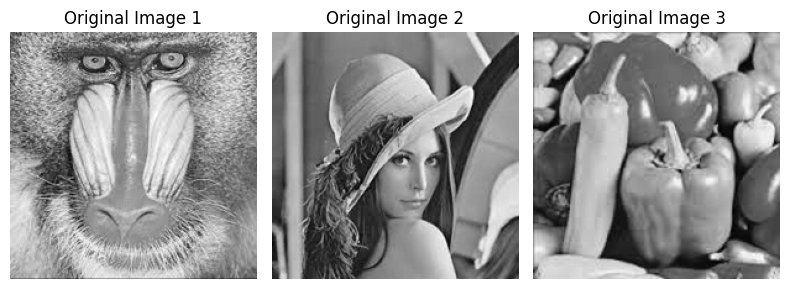

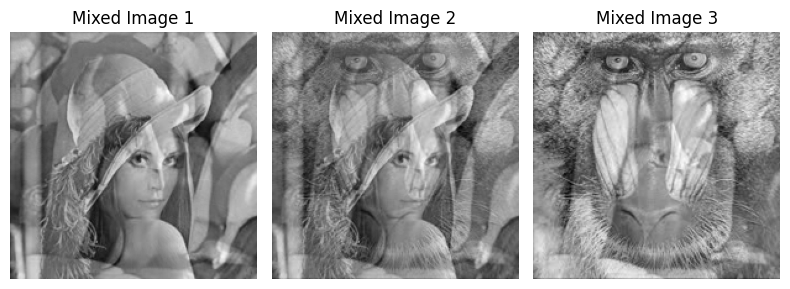

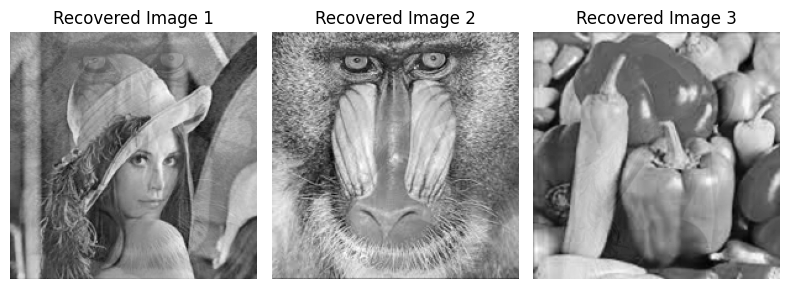

Correlations for Recovered Source 1: [0.20710557057051715, 0.9465767253299943, 0.11914249501756943]
Correlations for Recovered Source 2: [0.9758624128106232, -0.23660041167572574, -0.039398361528118424]
Correlations for Recovered Source 3: [0.06928083358393196, -0.21911811485685598, 0.9920951743607512]


In [55]:
np.random.seed(7)

# Paths to image files
original_paths = [
    "./ICA_Cocktail_Party_Problem/images/baboon.jpg",
    "./ICA_Cocktail_Party_Problem/images/lena.jpg",
    "./ICA_Cocktail_Party_Problem/images/peppers.jpg"
]

colored_images = [Image.open(path) for path in original_paths]

# Plot colored images
plt.figure(figsize=(8,4))
for i, img in enumerate(colored_images):
    plt.subplot(1, 3, i + 1)
    plt.imshow(np.array(img), cmap='gray')
    plt.title(f"Colored Image {i+1}")
    plt.axis('off')
plt.tight_layout()
plt.show()

# Load, resize and convert images to grayscale
gray_resized_images = [image.convert("L").resize((200, 200)) for image in colored_images]

# Plot gray resized images
plt.figure(figsize=(8,4))
for i, img in enumerate(gray_resized_images):
    plt.subplot(1, 3, i + 1)
    plt.imshow(np.array(img), cmap='gray')
    plt.title(f"Original Image {i+1}")
    plt.axis('off')
plt.tight_layout()
plt.show()

# Flatten to 1D
original_images = np.array([np.array(img).flatten() for img in gray_resized_images])

# Create a random mixing matrix (non-singular)
n_images = len(original_images)
mixing_matrix = np.random.rand(n_images, n_images)
while np.linalg.det(mixing_matrix) == 0:  # Ensure it's non-singular
    mixing_matrix = np.random.rand(n_images, n_images)

# Generate mixed signals
mixed_images = mixing_matrix @ original_images

# Reshape and plot mixed images
plt.figure(figsize=(8,4))
for i in range(n_images):
    plt.subplot(1, 3, i + 1)
    plt.imshow(mixed_images[i].reshape(200, 200), cmap='gray')
    plt.title(f"Mixed Image {i+1}")
    plt.axis('off')
plt.tight_layout()
plt.show()

# Apply FastICA to recover the original sources
ica = FastICA(n_components=n_images, random_state=7)
recovered_sources = ica.fit_transform(mixed_images.T)

# Transpose back for correct shape
recovered_sources = recovered_sources.T 

# Reshape and plot recovered images
plt.figure(figsize=(8,4))
for i in range(n_images):
    plt.subplot(1, 3, i + 1)
    plt.imshow(recovered_sources[i].reshape(200, 200), cmap='gray')
    plt.title(f"Recovered Image {i+1}")
    plt.axis('off')
plt.tight_layout()
plt.show()

for i, source in enumerate(recovered_sources):
    correlations = [np.corrcoef(source.flatten(), original_images[j].flatten())[0, 1] for j in range(len(original_images))]
    print(f"Correlations for Recovered Source {i+1}: {correlations}")